# Are We on Track for 2030?
Predicting Hunger Reduction in the Philippines: Analyzing Food Security Factors and Progress Toward 2030

key questions:
1. How does the Philippines’ progress in reducing hunger compare to global trends?
2. What are the key food security factors influencing hunger reduction in the Philippines?
3. What are the projected hunger levels in the Philippines by 2030?


Hypothesis
1.   The Philippines' hunger reduction progresses more slowly than the global average.
2.   Key food security factors such as GDP per capita, dietary energy supply, and protein supply influence hunger reduction in the Philippines; and Hunger reduction in the Phlippines has decreased due to increased GDP per capita, increased dietary energy supply, and higher protein supply.
3.   Hunger in the Philippines will continue to decrease by 2030, should current trends continue.




In [ ]:
# Load datasets
# get the updated at https://cs132zerohunger.framer.website/
import csv
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.font_manager as fm
import seaborn as sns
import geopandas as gpd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

df_ph = pd.read_csv('/content/CS132_dataset - PH DATA SET.csv')
df_ghi = pd.read_csv('/content/CS132_dataset - GHI SCORES.csv')


Design Settings according to PiliPinuts

--2025-05-05 15:01:16--  https://github.com/openmaptiles/fonts/raw/master/roboto/Roboto-Light.ttf
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/openmaptiles/fonts/master/roboto/Roboto-Light.ttf [following]
--2025-05-05 15:01:17--  https://raw.githubusercontent.com/openmaptiles/fonts/master/roboto/Roboto-Light.ttf
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 162420 (159K) [application/octet-stream]
Saving to: ‘Roboto-Light.ttf.3’

Roboto-Light.ttf.3  100%[===================>] 158.61K  --.-KB/s    in 0.02s   

2025-05-05 15:01:17 (6.26 MB/s) - ‘Roboto-Light.ttf.3’ saved [162420/162420]

--20

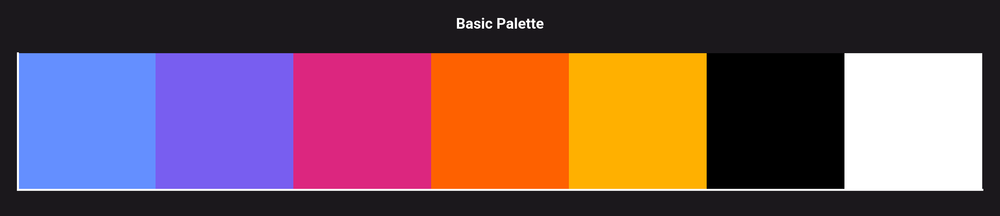

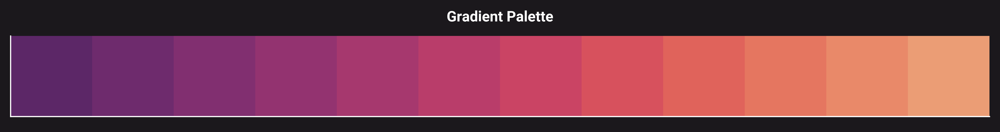

In [ ]:

# @title Download fonts
!wget 'https://github.com/openmaptiles/fonts/raw/master/roboto/Roboto-Light.ttf'
!wget 'https://github.com/openmaptiles/fonts/raw/master/roboto/Roboto-Regular.ttf'
!wget 'https://github.com/openmaptiles/fonts/raw/master/roboto/Roboto-Medium.ttf'
!wget 'https://github.com/openmaptiles/fonts/raw/master/roboto/Roboto-Bold.ttf'

# @title Typesetting
# https://stackoverflow.com/a/65841091
from matplotlib import font_manager as fm, pyplot as plt

font_files = fm.findSystemFonts('.')

# Install fonts
for font_file in font_files:
  fm.fontManager.addfont(font_file)

# @title Colors
colors = ["#648FFF", "#785EF0", "#DC267F", "#FE6100", "#FFB000", "#000000", "#FFFFFF"]
colors_grad = sns.color_palette('flare_r',  12)
colors_heat1 = sns.color_palette('flare_r', as_cmap=True)
colors_heat2 = sns.diverging_palette(315, 261, s=74, l=50, center='dark', as_cmap=True)

color_bg = "#1B181C"
color_text = "#FFFFFF"


sns.palplot(colors)
plt.gca().set_title('Basic Palette', fontsize=6, pad=10)

sns.palplot(colors_grad)
plt.gca().set_title('Gradient Palette', fontsize=10, pad=10)

plt.show()

# Heatmap Palette (1-way)
colors_heat1

# Heatmap Palette (2-way)
colors_heat2

# @title Plot settings
mpl.rcParams['figure.dpi'] = 600
mpl.rcParams["figure.figsize"] = 16,8

# Text
mpl.rcParams['font.family'] = 'Roboto'

# Title
mpl.rcParams['figure.titlesize'] = 32
mpl.rcParams['axes.titlesize'] = 32
mpl.rcParams['axes.titleweight'] = 'bold'

# Labels
mpl.rcParams['axes.labelsize'] = 22
mpl.rcParams['xtick.labelsize'] = 22
mpl.rcParams['ytick.labelsize'] = 22

# Spacing
mpl.rcParams['axes.titlepad'] = 72
mpl.rcParams['axes.labelpad'] = 10
mpl.rcParams['xtick.major.pad'] = 10
mpl.rcParams['ytick.major.pad'] = 10
mpl.rcParams['xtick.major.width'] = 0
mpl.rcParams['xtick.minor.width'] = 0
mpl.rcParams['ytick.major.width'] = 0
mpl.rcParams['ytick.minor.width'] = 0

# Spines and grids
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.grid'] = False

# Legends
mpl.rcParams['legend.title_fontsize'] = 18
mpl.rcParams['legend.fontsize'] = 18
mpl.rcParams['legend.frameon'] = False

# Bars
plt.rcParams['patch.linewidth'] = 0
plt.rcParams['patch.edgecolor'] = 'none'

# Colors
mpl.rcParams["figure.facecolor"] = color_bg
mpl.rcParams["axes.facecolor"] = color_bg
mpl.rcParams["savefig.facecolor"] = color_bg

# Text colors
mpl.rcParams['text.color'] = color_text
mpl.rcParams['axes.labelcolor'] = color_text
mpl.rcParams['xtick.color'] = color_text
mpl.rcParams['ytick.color'] = color_text

# Line colors
mpl.rcParams['axes.edgecolor'] = color_text



In [ ]:
# Check first few rows
df_ph.head()
df_ghi.head()

# Check columns
df_ph.columns
df_ghi.columns


Index(['Iso3', 'Country ', 'GHI Ranking',
       'GHI Index Score by 2000 range (1998–2004) ',
       'GHI Index Score by 2008 range (2005–2012) ',
       'GHI Index Score by 2016 range (2013–2020)',
       'GHI Index Score by 2024 range (2021–2024)',
       'Absolute change since 2016', '% change since 2016',
       'Undernourishment \n(% of population) 2000 ('00–'02)',
       'Undernourishment \n(% of population) 2008 ('07–'09)',
       'Undernourishment \n(% of population) 2016 ('15–'17)',
       'Undernourishment \n(% of population) 2024 ('21–'23)',
       'Child wasting 2000 ('98–'02)(% of children under five years old)',
       'Child wasting 2008 ('06–'10) (% of children under five years old)',
       'Child wasting ('14–'18) (% of children under five years old)',
       'Child wasting ('19–'23) (% of children under five years old)',
       'Child stunting ('98–'02) (% of children under five years old)',
       'Child stunting ('06–'10) (% of children under five years old)',
   

#Cleaning the data and fix missing values

In [ ]:
# Cleaning columns and values
df_ghi.columns = df_ghi.columns.str.strip().str.replace('"', '')
df_ph.columns = df_ph.columns.str.strip().str.replace('"', '')

for df in [df_ghi, df_ph]:
    for col in df.columns:
        if df[col].dtype == 'object':
            df[col] = df[col].str.strip().str.replace('"', '').replace('', np.nan)

# Missing Values
print("\nMissing values in GHI dataset:")
print(df_ghi.isnull().sum())
print("\nMissing values in PH dataset:")
print(df_ph.isnull().sum())

# Remove duplicates
df_ghi.drop_duplicates(inplace=True)
df_ph.drop_duplicates(inplace=True)

# Split data
# For GHI dataset (used for Question 1)
df_ghi_train, df_ghi_test = train_test_split(df_ghi, test_size=0.2, random_state=42)

# For PH dataset (used for Questions 2 and 3)
df_ph_train, df_ph_test = train_test_split(df_ph, test_size=0.2, random_state=42)

# Fill missing values
for df_train, df_test in [(df_ghi_train, df_ghi_test), (df_ph_train, df_ph_test)]:
    for col in df_train.select_dtypes(include=[np.number]):
        median_value = df_train[col].median()
        df_train[col] = df_train[col].fillna(median_value)
        df_test[col] = df_test[col].fillna(median_value)

# Drop rows with remaining missing values
df_ghi_train.dropna(inplace=True)
df_ghi_test.dropna(inplace=True)
df_ph_train.dropna(inplace=True)
df_ph_test.dropna(inplace=True)


Missing values in GHI dataset:
Iso3                                                                 0
Country                                                              0
GHI Ranking                                                          6
GHI Index Score by 2000 range (1998–2004)                            6
GHI Index Score by 2008 range (2005–2012)                            6
GHI Index Score by 2016 range (2013–2020)                            6
GHI Index Score by 2024 range (2021–2024)                            6
Absolute change since 2016                                           0
% change since 2016                                                  0
Undernourishment \n(% of population) 2000 ('00–'02)                  0
Undernourishment \n(% of population) 2008 ('07–'09)                  0
Undernourishment \n(% of population) 2016 ('15–'17)                  0
Undernourishment \n(% of population) 2024 ('21–'23)                  0
Child wasting 2000 ('98–'02)(% of children un

#Data Exploration

In [ ]:
print("\nSummary of GHI data set:")
print(df_ghi.describe())

print("\nSummary of PH data set:")
print(df_ph.describe())


Summary of GHI data set:
       Child mortality 2016 (% of children under five years old)  \
count                                         136.000000           
mean                                            3.855882           
std                                             3.260760           
min                                             0.300000           
25%                                             1.300000           
50%                                             2.550000           
75%                                             5.700000           
max                                            12.900000           

       Child mortality 2024 (% of children under five years old)  
count                                         136.000000          
mean                                            3.218382          
std                                             2.778361          
min                                             0.200000          
25%                       

#Question 1: How does the Philippines’ progress in reducing hunger compare to global trends?
**bold text**

In [ ]:
print(df_ghi.columns)

Index(['Iso3', 'Country', 'GHI Ranking',
       'GHI Index Score by 2000 range (1998–2004)',
       'GHI Index Score by 2008 range (2005–2012)',
       'GHI Index Score by 2016 range (2013–2020)',
       'GHI Index Score by 2024 range (2021–2024)',
       'Absolute change since 2016', '% change since 2016',
       'Undernourishment \n(% of population) 2000 ('00–'02)',
       'Undernourishment \n(% of population) 2008 ('07–'09)',
       'Undernourishment \n(% of population) 2016 ('15–'17)',
       'Undernourishment \n(% of population) 2024 ('21–'23)',
       'Child wasting 2000 ('98–'02)(% of children under five years old)',
       'Child wasting 2008 ('06–'10) (% of children under five years old)',
       'Child wasting ('14–'18) (% of children under five years old)',
       'Child wasting ('19–'23) (% of children under five years old)',
       'Child stunting ('98–'02) (% of children under five years old)',
       'Child stunting ('06–'10) (% of children under five years old)',
      

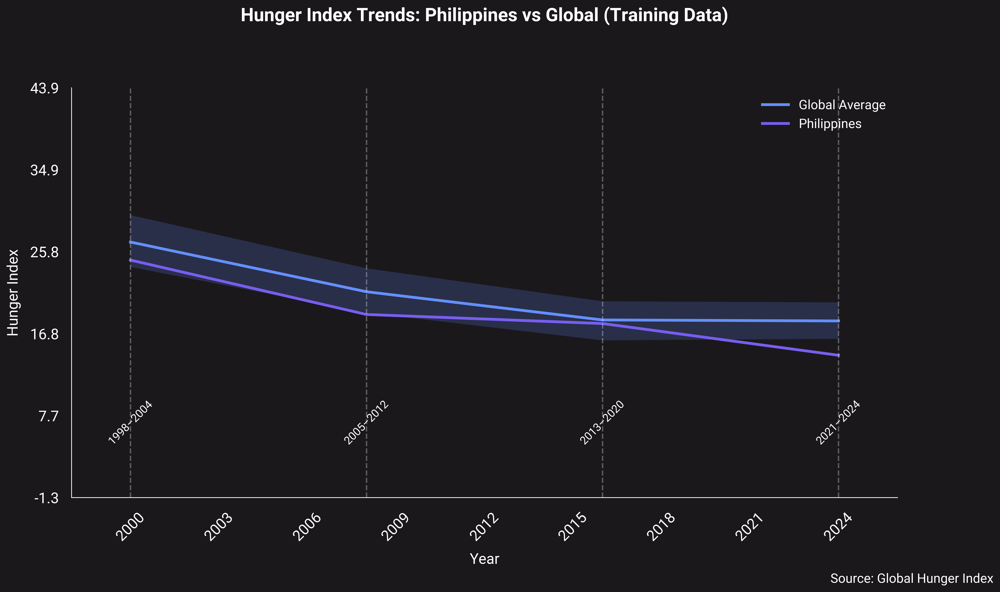

In [ ]:
df_ghi_train.rename(columns={
    'GHI Index Score by 2000 range (1998–2004)': '2000',
    'GHI Index Score by 2008 range (2005–2012)': '2008',
    'GHI Index Score by 2016 range (2013–2020)': '2016',
    'GHI Index Score by 2024 range (2021–2024)': '2024'
}, inplace=True)

df_ghi_test.rename(columns={
    'GHI Index Score by 2000 range (1998–2004)': '2000',
    'GHI Index Score by 2008 range (2005–2012)': '2008',
    'GHI Index Score by 2016 range (2013–2020)': '2016',
    'GHI Index Score by 2024 range (2021–2024)': '2024'
}, inplace=True)

# Reshape training data
df_ghi_long_train = df_ghi_train.melt(
    id_vars=['Country'],
    value_vars=['2000', '2008', '2016', '2024'],
    var_name='year',
    value_name='hunger_index'
)

# Convert to numeric
df_ghi_long_train['year'] = pd.to_numeric(df_ghi_long_train['year'], errors='coerce')
df_ghi_long_train['hunger_index'] = pd.to_numeric(df_ghi_long_train['hunger_index'], errors='coerce')

# Drop missing values
df_ghi_long_train.dropna(subset=['hunger_index'], inplace=True)

df_ghi_long_train['Country'] = df_ghi_long_train['Country'].str.strip()
df_ph_ghi_train = df_ghi_long_train[df_ghi_long_train['Country'] == 'Philippines']

# Define standardized time ranges for vertical lines
time_ranges = {
    2000: '1998–2004',
    2008: '2005–2012',
    2016: '2013–2020',
    2024: '2021–2024'
}
range_years = sorted(time_ranges.keys())

plt.figure(facecolor=color_bg)
ax = plt.gca()
ax.set_facecolor(color_bg)

# Global Average
sns.lineplot(
    data=df_ghi_long_train,
    x='year',
    y='hunger_index',
    label='Global Average',
    estimator='mean',
    color=colors[0],
    linewidth=3
)

# Philippines
sns.lineplot(
    data=df_ph_ghi_train,
    x='year',
    y='hunger_index',
    label='Philippines',
    color=colors[1],
    linewidth=3
)

# Set y-axis
y_min_global = df_ghi_long_train['hunger_index'].mean() - 1.5 * df_ghi_long_train['hunger_index'].std()
y_max_global = df_ghi_long_train['hunger_index'].mean() + 1.5 * df_ghi_long_train['hunger_index'].std()
y_min_ph = df_ph_ghi_train['hunger_index'].min()
y_max_ph = df_ph_ghi_train['hunger_index'].max()

y_min = min(y_min_global, y_min_ph) if not pd.isna(y_min_global) and not pd.isna(y_min_ph) else 0
y_max = max(y_max_global, y_max_ph) if not pd.isna(y_max_global) and not pd.isna(y_max_ph) else 50
y_range = y_max - y_min if y_max != y_min else 10
y_padding = 2.0 if y_range < 10 else y_range * 0.1
step = 5.0 if y_range > 20 else 2.0  # Adjust step size based on range
y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)


if len(y_ticks) > 8:
    y_ticks = np.linspace(y_min - y_padding, y_max + y_padding, 6)

ax.set_ylim(y_min - y_padding, y_max + y_padding)
ax.set_yticks(y_ticks)
ax.set_yticklabels(['%.1f' % y for y in y_ticks], fontsize=16, color=color_text)

# Set x-axis
x_ticks = np.arange(2000, 2025, 3)
ax.set_xticks(x_ticks)
ax.set_xticklabels([int(x) for x in x_ticks], fontsize=16, color=color_text, rotation=45)
ax.set_xlim(1998, 2026)  # Slightly wider range for better visualization

# Title and Labels
plt.title('Hunger Index Trends: Philippines vs Global (Training Data)', fontsize=20, color=color_text)
plt.xlabel('Year', fontsize=16, color=color_text)
plt.ylabel('Hunger Index', fontsize=16, color=color_text)

# Vertical lines
for year in range_years:
    plt.axvline(x=year, color='white', linestyle='--', alpha=0.3)
    plt.text(year, y_min + 0.05 * (y_max - y_min), time_ranges[year], rotation=45, ha='center', va='bottom', fontsize=12, color=color_text)

# Legend
plt.legend(
    title='',
    loc='upper right',
    fontsize=14,
    labelcolor=color_text
)

# Reference
plt.figtext(0.99, -0.05, 'Source: Global Hunger Index', ha='right', fontsize=14, color=color_text)

#spines and ticks
ax.tick_params(axis='x', colors=color_text)
ax.tick_params(axis='y', colors=color_text)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_color(color_text)
ax.spines['bottom'].set_color(color_text)

plt.show()

#Question 2: What are the key food security factors influencing hunger reduction in the Philippines?

In [ ]:
key_indicators = [
    'Average dietary energy supply adequacy (percent) (3-year average)',
    'Dietary energy supply used in the estimation of prevalence of undernourishment (kcal/cap/day)',
    'Average protein supply (g/cap/day) (3-year average)',
    'Average supply of protein of animal origin (g/cap/day) (3-year average)',
    'Gross domestic product per capita, PPP, (constant 2017 international $)',
    'Prevalence of undernourishment (percent) (3-year average)',
    'Number of people undernourished (million) (3-year average)',
    'Prevalence of moderate or severe food insecurity in the total population (percent) (3-year average)',
    'Number of moderately or severely food insecure people (million) (3-year average)'
]

short_titles = {
    'Average dietary energy supply adequacy (percent) (3-year average)': 'Dietary Energy Adequacy (%)',
    'Dietary energy supply used in the estimation of prevalence of undernourishment (kcal/cap/day)': 'Dietary Energy Supply (kcal/cap/day)',
    'Average protein supply (g/cap/day) (3-year average)': 'Protein Supply (g/cap/day)',
    'Average supply of protein of animal origin (g/cap/day) (3-year average)': 'Animal Protein Supply (g/cap/day)',
    'Gross domestic product per capita, PPP, (constant 2017 international $)': 'GDP per Capita ($)',
    'Prevalence of undernourishment (percent) (3-year average)': 'Undernourishment (%)',
    'Number of people undernourished (million) (3-year average)': 'Undernourished Population (M)',
    'Prevalence of moderate or severe food insecurity in the total population (percent) (3-year average)': 'Food Insecurity (%)',
    'Number of moderately or severely food insecure people (million) (3-year average)': 'Food Insecure Population (M)'
}

# Clean and prepare
df_clean_train = df_ph_train.copy()
df_clean_train['Year'] = pd.to_numeric(df_clean_train['GHI Reference Year'], errors='coerce')
df_clean_train['Value'] = pd.to_numeric(df_clean_train['Value'], errors='coerce')
df_clean_train['Item'] = df_clean_train['Item'].astype(str)

raw_years = df_clean_train['Year'].dropna().unique()
print(f"Raw years in training data: {sorted(raw_years)}")

# Filter and aggregate
df_filtered_train = df_clean_train[df_clean_train['Item'].isin(key_indicators)]
df_pivot_train = df_filtered_train.groupby(['Year', 'Item'])['Value'].mean().unstack()
df_pivot_train = df_pivot_train.dropna(how='all')
years = df_pivot_train.index
print(f"Years in pivoted training data: {sorted(years)}")
print("\nPivoted data (first few rows):")
print(df_pivot_train.head())
print("\nData availability for indicators:")
for indicator in key_indicators:
    points = df_pivot_train[indicator].notna().sum() if indicator in df_pivot_train.columns else 0
    print(f"{short_titles[indicator]}: {points} data points")


valid_indicators = [ind for ind in key_indicators if df_pivot_train[ind].notna().sum() > 0]
print("\nValid indicators with data:")
for ind in valid_indicators:
    print(f"{short_titles[ind]}: {df_pivot_train[ind].notna().sum()} data points")
df_pivot_train = df_pivot_train[valid_indicators]

# Calculate correlations
correlation_matrix = df_pivot_train.corr()
print("\nOriginal correlation matrix:\n", correlation_matrix)

correlation_matrix = correlation_matrix.reindex(index=key_indicators, columns=key_indicators, fill_value=0)
correlation_matrix = correlation_matrix.fillna(0)
print("\nCorrelation matrix (after filling NaN with 0):\n", correlation_matrix.rename(index=short_titles, columns=short_titles))
undernourishment_col = 'Prevalence of undernourishment (percent) (3-year average)'
strong_correlations = correlation_matrix[undernourishment_col][abs(correlation_matrix[undernourishment_col]) > 0.5].index.tolist()
strong_correlations = [col for col in strong_correlations if col != undernourishment_col]

time_ranges = {
    2000: '1998–2004',
    2008: '2005–2012',
    2016: '2013–2020',
    2024: '2021–2024'
}
range_years = sorted(time_ranges.keys())

# Define x-axis
x_ticks = np.arange(int(min(years)), int(max(years)) + 1, 3)

# Combine
fig, axes = plt.subplots(3, 3, figsize=(20, 15), sharex=True)
axes = axes.flatten()
fig.set_facecolor(color_bg)

for idx, indicator in enumerate(key_indicators):
    ax = axes[idx]
    ax.set_facecolor(color_bg)
    if indicator not in df_pivot_train.columns or df_pivot_train[indicator].notna().sum() == 0:
        print(f"Warning: No data for {short_titles[indicator]}")
        ax.set_title(short_titles[indicator], fontsize=16, color=color_text)
        ax.set_xlabel('Year', fontsize=12, color=color_text)
        ax.set_ylabel(short_titles[indicator], fontsize=12, color=color_text)
        ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color=color_text, transform=ax.transAxes)
        ax.set_xticks(x_ticks)
        ax.set_xticklabels([int(x) for x in x_ticks], fontsize=10, color=color_text, rotation=45)
        ax.set_xlim(min(years) - 0.5, max(years) + 0.5)
        #vertical lines
        for year in range_years:
            ax.axvline(x=year, color='white', linestyle='--', alpha=0.3)
            ax.text(year, 0.05, time_ranges[year], rotation=45, ha='center', va='bottom', fontsize=8, color=color_text)
        ax.tick_params(axis='x', colors=color_text)
        ax.tick_params(axis='y', colors=color_text)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_color(color_text)
        ax.spines['bottom'].set_color(color_text)
        continue


    plt.sca(ax)
    plt.plot(df_pivot_train.index, df_pivot_train[indicator], color=colors[0], linewidth=2, label=short_titles[indicator])
    y_min, y_max = df_pivot_train[indicator].dropna().min(), df_pivot_train[indicator].dropna().max()
    y_range = y_max - y_min
    # Adjust padding and ticks for small ranges
    if indicator in [
        'Prevalence of undernourishment (percent) (3-year average)',
        'Average dietary energy supply adequacy (percent) (3-year average)'
    ]:
        y_padding = 1.0 if y_range < 2 else y_range * 0.1
        step = 0.5
        y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)
        y_format = '%.1f'
    elif indicator in [
        'Number of people undernourished (million) (3-year average)'
    ]:
        y_padding = 0.1 if y_range < 0.5 else y_range * 0.1
        step = 0.1
        y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)
        y_format = '%.1f'
    elif indicator == 'Gross domestic product per capita, PPP, (constant 2017 international $)':
        y_padding = 500 if y_range < 2000 else y_range * 0.1
        step = 1000
        y_ticks = np.arange(round(y_min - y_padding, -3), y_max + y_padding + step, step)
        y_format = '%.0f'
    elif indicator == 'Dietary energy supply used in the estimation of prevalence of undernourishment (kcal/cap/day)':
        y_padding = 100 if y_range < 500 else y_range * 0.1
        step = 200
        y_ticks = np.arange(round(y_min - y_padding, -2), y_max + y_padding + step, step)
        y_format = '%.0f'
    else:
        y_padding = 1.0 if y_range < 5 else y_range * 0.1
        step = 1.0
        y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)
        y_format = '%.1f'


    if len(y_ticks) > 8:
        y_ticks = np.linspace(y_min - y_padding, y_max + y_padding, 6)
        y_format = '%.1f' if y_range < 10 else '%.0f'

    ax.set_ylim(y_min - y_padding, y_max + y_padding)
    ax.set_yticks(y_ticks)
    ax.set_yticklabels([y_format % y for y in y_ticks], fontsize=10, color=color_text)

    ax.set_xlabel('Year', fontsize=12, color=color_text)
    ax.set_ylabel(short_titles[indicator], fontsize=12, color=color_text)
    ax.set_title(short_titles[indicator], fontsize=16, color=color_text)

    ax.set_xticks(x_ticks)
    ax.set_xticklabels([int(x) for x in x_ticks], fontsize=10, color=color_text, rotation=45)
    ax.set_xlim(min(years) - 0.5, max(years) + 0.5)

    # Add vertical lines
    for year in range_years:
        ax.axvline(x=year, color='white', linestyle='--', alpha=0.3)
        ax.text(year, y_min + 0.05 * (y_max - y_min), time_ranges[year], rotation=45, ha='center', va='bottom', fontsize=8, color=color_text)

    if indicator in strong_correlations and df_pivot_train[undernourishment_col].notna().sum() > 0:
        ax2 = ax.twinx()
        plt.plot(df_pivot_train.index, df_pivot_train[undernourishment_col], color=colors[1], linewidth=1.5, linestyle='--', label='Undernourishment (%)')
        ax2.set_ylabel('Undernourishment (%)', color=colors[1], fontsize=12)
        ax2.tick_params(axis='y', labelcolor=colors[1])
        y_min2, y_max2 = df_pivot_train[undernourishment_col].dropna().min(), df_pivot_train[undernourishment_col].dropna().max()
        y_range2 = y_max2 - y_min2
        y_padding2 = 1.0 if y_range2 < 2 else y_range2 * 0.1
        step2 = 0.5
        y_ticks2 = np.arange(round(y_min2 - y_padding2, 1), y_max2 + y_padding2 + step2, step2)
        if len(y_ticks2) > 8:
            y_ticks2 = np.linspace(y_min2 - y_padding2, y_max2 + y_padding2, 6)
        ax2.set_ylim(y_min2 - y_padding2, y_max2 + y_padding2)
        ax2.set_yticks(y_ticks2)
        ax2.set_yticklabels(['%.1f' % y for y in y_ticks2], fontsize=10, color=colors[1])
        lines1, labels1 = ax.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax.legend(lines1 + lines2, labels1 + labels2, loc='upper right', fontsize=10)
    else:
        ax.legend(loc='upper right', fontsize=10)

    ax.tick_params(axis='x', colors=color_text)
    ax.tick_params(axis='y', colors=color_text)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_color(color_text)
    ax.spines['bottom'].set_color(color_text)

    # Print y-axis
    print(f"\nY-axis for {short_titles[indicator]} (combined): min={y_min:.2f}, max={y_max:.2f}, padding={y_padding:.2f}, ticks={[float(y_format % y) for y in y_ticks]}")

fig.suptitle('Food Security Indicators in the Philippines (Training Data)', fontsize=32, y=1.08, color=color_text)
fig.text(0.99, 0.01, 'Source: Food Security Indicators', ha='right', fontsize=14, color=color_text)
plt.tight_layout()
plt.savefig('food_security_indicators_combined.png')
plt.show()

# Individual plots
for indicator in key_indicators:
    plt.figure(facecolor=color_bg)
    ax1 = plt.gca()
    ax1.set_facecolor(color_bg)

    if indicator not in df_pivot_train.columns or df_pivot_train[indicator].notna().sum() == 0:
        print(f"Warning: No data for {short_titles[indicator]}")
        ax1.set_title(f'{short_titles[indicator]} Over Time (Training Data)\nNo Data', color=color_text)
        ax1.set_xlabel('Year', color=color_text)
        ax1.set_ylabel(short_titles[indicator], color=color_text)
        ax1.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=14, color=color_text, transform=ax1.transAxes)
        ax1.set_xticks(x_ticks)
        ax1.set_xticklabels([int(x) for x in x_ticks], color=color_text, rotation=45)
        ax1.set_xlim(min(years) - 0.5, max(years) + 0.5)
        for year in range_years:
            ax1.axvline(x=year, color='white', linestyle='--', alpha=0.3)
            ax1.text(year, 0.05, time_ranges[year], rotation=45, ha='center', va='bottom', fontsize=12, color=color_text)
        ax1.tick_params(axis='x', colors=color_text)
        ax1.tick_params(axis='y', colors=color_text)
        ax1.spines['top'].set_visible(False)
        ax1.spines['right'].set_visible(False)
        ax1.spines['left'].set_color(color_text)
        ax1.spines['bottom'].set_color(color_text)
        plt.figtext(0.99, 0.01, 'Source: Food Security Indicators', ha='right', fontsize=14, color=color_text)
        plt.savefig(f"{short_titles[indicator].replace(' ', '_').replace('(', '').replace(')', '').replace('/', '_')}_trend.png")
        plt.show()
        continue


    plt.plot(df_pivot_train.index, df_pivot_train[indicator], color=colors[0], linewidth=3, label=short_titles[indicator])
    y_min, y_max = df_pivot_train[indicator].dropna().min(), df_pivot_train[indicator].dropna().max()
    y_range = y_max - y_min

    if indicator in [
        'Prevalence of undernourishment (percent) (3-year average)',
        'Average dietary energy supply adequacy (percent) (3-year average)'
    ]:
        y_padding = 1.0 if y_range < 2 else y_range * 0.1
        step = 0.5
        y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)
        y_format = '%.1f'
    elif indicator in [
        'Number of people undernourished (million) (3-year average)'
    ]:
        y_padding = 0.1 if y_range < 0.5 else y_range * 0.1
        step = 0.1
        y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)
        y_format = '%.1f'
    elif indicator == 'Gross domestic product per capita, PPP, (constant 2017 international $)':
        y_padding = 500 if y_range < 2000 else y_range * 0.1
        step = 1000
        y_ticks = np.arange(round(y_min - y_padding, -3), y_max + y_padding + step, step)
        y_format = '%.0f'
    elif indicator == 'Dietary energy supply used in the estimation of prevalence of undernourishment (kcal/cap/day)':
        y_padding = 100 if y_range < 500 else y_range * 0.1
        step = 200
        y_ticks = np.arange(round(y_min - y_padding, -2), y_max + y_padding + step, step)
        y_format = '%.0f'
    else:
        y_padding = 1.0 if y_range < 5 else y_range * 0.1
        step = 1.0
        y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)
        y_format = '%.1f'

    if len(y_ticks) > 8:
        y_ticks = np.linspace(y_min - y_padding, y_max + y_padding, 6)
        y_format = '%.1f' if y_range < 10 else '%.0f'

    ax1.set_ylim(y_min - y_padding, y_max + y_padding)
    ax1.set_yticks(y_ticks)
    ax1.set_yticklabels([y_format % y for y in y_ticks], fontsize=10, color=color_text)

    ax1.set_xlabel('Year', color=color_text)
    ax1.set_ylabel(short_titles[indicator], color=color_text)

    if indicator in strong_correlations and df_pivot_train[undernourishment_col].notna().sum() > 0:
        ax2 = ax1.twinx()
        plt.plot(df_pivot_train.index, df_pivot_train[undernourishment_col], color=colors[1], linewidth=2, linestyle='--', label='Undernourishment (%)')
        ax2.set_ylabel('Undernourishment (%)', color=colors[1])
        ax2.tick_params(axis='y', labelcolor=colors[1])
        y_min2, y_max2 = df_pivot_train[undernourishment_col].dropna().min(), df_pivot_train[undernourishment_col].dropna().max()
        y_range2 = y_max2 - y_min2
        y_padding2 = 1.0 if y_range2 < 2 else y_range2 * 0.1
        step2 = 0.5
        y_ticks2 = np.arange(round(y_min2 - y_padding2, 1), y_max2 + y_padding2 + step2, step2)
        if len(y_ticks2) > 8:
            y_ticks2 = np.linspace(y_min2 - y_padding2, y_max2 + y_padding2, 6)
        ax2.set_ylim(y_min2 - y_padding2, y_max2 + y_padding2)
        ax2.set_yticks(y_ticks2)
        ax2.set_yticklabels(['%.1f' % y for y in y_ticks2], fontsize=10, color=colors[1])
        lines1, labels1 = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper right')
    else:
        ax1.legend(loc='upper right')

    ax1.set_xticks(x_ticks)
    ax1.set_xticklabels([int(x) for x in x_ticks], color=color_text, rotation=45)
    ax1.set_xlim(min(years) - 0.5, max(years) + 0.5)

    for year in range_years:
        ax1.axvline(x=year, color='white', linestyle='--', alpha=0.3)
        ax1.text(year, y_min + 0.05 * (y_max - y_min), time_ranges[year], rotation=45, ha='center', va='bottom', fontsize=12, color=color_text)

    min_idx = df_pivot_train[indicator].idxmin()
    max_idx = df_pivot_train[indicator].idxmax()
    ax1.annotate(f'Min: {df_pivot_train[indicator][min_idx]:.1f}', xy=(min_idx, df_pivot_train[indicator][min_idx]),
                 xytext=(min_idx, df_pivot_train[indicator][min_idx] - y_padding), fontsize=14, color=colors[2])
    ax1.annotate(f'Max: {df_pivot_train[indicator][max_idx]:.1f}', xy=(max_idx, df_pivot_train[indicator][max_idx]),
                 xytext=(max_idx, df_pivot_train[indicator][max_idx] + y_padding), fontsize=14, color=colors[3])

    corr = correlation_matrix.loc[indicator, undernourishment_col] if indicator != undernourishment_col else 1.0
    corr_text = f'Correlation with hunger: r = {corr:.2f}'
    strength = 'Strong' if abs(corr) > 0.5 else 'Weak'
    plt.title(f'{short_titles[indicator]} Over Time (Training Data)\n{strength} {corr_text}', color=color_text)

    ax1.tick_params(axis='x', colors=color_text)
    ax1.tick_params(axis='y', colors=color_text)
    ax1.spines['top'].set_visible(False)
    ax1.spines['right'].set_visible(False)
    ax1.spines['left'].set_color(color_text)
    ax1.spines['bottom'].set_color(color_text)
    plt.figtext(0.99, 0.01, 'Source: Food Security Indicators', ha='right', fontsize=14, color=color_text)
    plt.savefig(f"{short_titles[indicator].replace(' ', '_').replace('(', '').replace(')', '').replace('/', '_')}_trend.png")
    plt.show()

    print(f"Y-axis for {short_titles[indicator]} (individual): min={y_min:.2f}, max={y_max:.2f}, padding={y_padding:.2f}, ticks={[float(y_format % y) for y in y_ticks]}")

# Correlation heatmap
plt.figure(facecolor=color_bg)
ax = plt.gca()
ax.set_facecolor(color_bg)
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
sns.heatmap(correlation_matrix, annot=True, cmap=colors_heat2, center=0, mask=mask, annot_kws={'size': 14},
            xticklabels=[short_titles.get(col, col) for col in correlation_matrix.columns],
            yticklabels=[short_titles.get(col, col) for col in correlation_matrix.index],
            cbar_kws={'label': 'Correlation'})
plt.title('Correlation of Food Security Indicators (Training Data)', color=color_text)
plt.figtext(0.99, 0.01, 'Source: Food Security Indicators', ha='right', fontsize=14, color=color_text)
ax.tick_params(axis='x', colors=color_text)
ax.tick_params(axis='y', colors=color_text)
plt.show()

print("\nCorrelations with Undernourishment (%):")
if undernourishment_col in correlation_matrix.columns:
    correlations = correlation_matrix[undernourishment_col].sort_values()
    print(correlations.rename(index=short_titles))

Raw years in training data: [np.int64(2000), np.int64(2008), np.int64(2016), np.int64(2024)]
Years in pivoted training data: [2000, 2008, 2016, 2024]

Pivoted data (first few rows):
Item  Average dietary energy supply adequacy (percent) (3-year average)  \
Year                                                                      
2000                                         110.000000                   
2008                                         113.666667                   
2016                                         121.142857                   
2024                                         125.000000                   

Item  Average protein supply (g/cap/day) (3-year average)  \
Year                                                        
2000                                            55.6400     
2008                                            63.7125     
2016                                            72.9750     
2024                                                NaN     



Y-axis for Dietary Energy Adequacy (%) (individual): min=110.00, max=125.00, padding=1.50, ticks=[108.0, 112.0, 116.0, 119.0, 123.0, 126.0]


Y-axis for Dietary Energy Supply (kcal/cap/day) (individual): min=2392.25, max=2832.50, padding=100.00, ticks=[2300.0, 2500.0, 2700.0, 2900.0, 3100.0]


Y-axis for Protein Supply (g/cap/day) (individual): min=55.64, max=72.97, padding=1.73, ticks=[54.0, 58.0, 62.0, 66.0, 71.0, 75.0]


Y-axis for Animal Protein Supply (g/cap/day) (individual): min=22.80, max=29.41, padding=0.66, ticks=[22.1, 23.7, 25.3, 26.9, 28.5, 30.1]


Y-axis for GDP per Capita ($) (individual): min=5028.18, max=9325.70, padding=429.75, ticks=[5000.0, 6000.0, 7000.0, 8000.0, 9000.0, 10000.0]


Y-axis for Undernourishment (%) (individual): min=5.90, max=17.10, padding=1.12, ticks=[5.0, 7.0, 10.0, 13.0, 16.0, 18.0]


Y-axis for Undernourished Population (M) (individual): min=6.90, max=13.90, padding=0.70, ticks=[6.2, 7.9, 9.6, 11.2, 12.9, 14.6]


Y-axis for Food Insecurity (%) (individual): min=39.25, max=44.13, padding=1.00, ticks=[38.3, 39.3, 40.3, 41.3, 42.3, 43.3, 44.3, 45.3]


Y-axis for Food Insecure Population (M) (individual): min=44.46, max=51.00, padding=0.65, ticks=[43.8, 45.4, 46.9, 48.5, 50.1, 51.7]



Correlations with Undernourishment (%):
Item
Food Insecurity (%)                    -1.000000
Food Insecure Population (M)           -1.000000
Protein Supply (g/cap/day)             -0.999975
GDP per Capita ($)                     -0.987204
Dietary Energy Adequacy (%)            -0.984809
Animal Protein Supply (g/cap/day)      -0.963432
Dietary Energy Supply (kcal/cap/day)   -0.956149
Undernourished Population (M)           0.997952
Undernourishment (%)                    1.000000
Name: Prevalence of undernourishment (percent) (3-year average), dtype: float64


#Question 3:What are the projected hunger levels in the Philippines by 2030?

Model Performance on Training Data:
Mean Squared Error (MSE): 1.09
R-squared (R2): 0.92


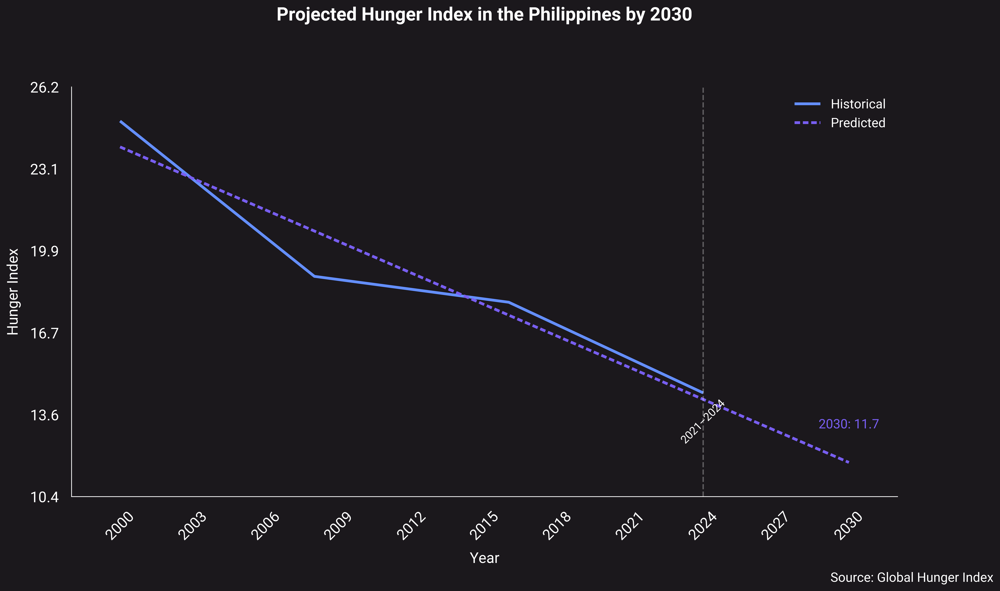

In [ ]:
df_ghi_train.rename(columns={
    'GHI Index Score by 2000 range (1998–2004)': '2000',
    'GHI Index Score by 2008 range (2005–2012)': '2008',
    'GHI Index Score by 2016 range (2013–2020)': '2016',
    'GHI Index Score by 2024 range (2021–2024)': '2024'
}, inplace=True)
df_ghi_long_train = df_ghi_train.melt(
    id_vars=['Country'],
    value_vars=['2000', '2008', '2016', '2024'],
    var_name='year',
    value_name='hunger_index'
)
df_ghi_long_train['year'] = pd.to_numeric(df_ghi_long_train['year'], errors='coerce')
df_ghi_long_train['hunger_index'] = pd.to_numeric(df_ghi_long_train['hunger_index'], errors='coerce')
df_ghi_long_train.dropna(subset=['hunger_index'], inplace=True)
df_ghi_long_train['Country'] = df_ghi_long_train['Country'].str.strip()
df_ph_ghi_train = df_ghi_long_train[df_ghi_long_train['Country'] == 'Philippines']

# Prepare data
X = df_ph_ghi_train['year'].values.reshape(-1, 1)
y = df_ph_ghi_train['hunger_index'].values

# Fit linear regression model
model = LinearRegression()
model.fit(X, y)

# Predict future values
future_years = np.arange(2000, 2031, 1).reshape(-1, 1)
predictions = model.predict(future_years)
y_pred_train = model.predict(X)
mse = mean_squared_error(y, y_pred_train)
r2 = r2_score(y, y_pred_train)
print(f"Model Performance on Training Data:")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"R-squared (R2): {r2:.2f}")

# Visualization
historical_data = pd.DataFrame({'Year': df_ph_ghi_train['year'], 'Hunger Index': df_ph_ghi_train['hunger_index'], 'Type': 'Historical'})
future_data = pd.DataFrame({'Year': future_years.flatten(), 'Hunger Index': predictions, 'Type': 'Predicted'})
plot_data = pd.concat([historical_data, future_data], ignore_index=True)
plt.figure(facecolor=color_bg)
ax = plt.gca()
ax.set_facecolor(color_bg)

sns.lineplot(
    data=plot_data,
    x='Year',
    y='Hunger Index',
    hue='Type',
    style='Type',
    palette=[colors[0], colors[1]],
    linewidth=3,
    dashes={'Historical': (1, 0), 'Predicted': (2, 1)}
)

#y-axis
y_min = plot_data['Hunger Index'].min()
y_max = plot_data['Hunger Index'].max()
y_range = y_max - y_min if y_max != y_min else 10
y_padding = 2.0 if y_range < 10 else y_range * 0.1
step = 5.0 if y_range > 20 else 2.0
y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)
if len(y_ticks) > 8:
    y_ticks = np.linspace(y_min - y_padding, y_max + y_padding, 6)

ax.set_ylim(y_min - y_padding, y_max + y_padding)
ax.set_yticks(y_ticks)
ax.set_yticklabels(['%.1f' % y for y in y_ticks], fontsize=16, color=color_text)

#x-axis
x_ticks = np.arange(2000, 2031, 3)
ax.set_xticks(x_ticks)
ax.set_xticklabels([int(x) for x in x_ticks], fontsize=16, color=color_text, rotation=45)
ax.set_xlim(1998, 2032)



# Title and labels
plt.title('Projected Hunger Index in the Philippines by 2030', fontsize=20, color=color_text)
plt.xlabel('Year', fontsize=16, color=color_text)
plt.ylabel('Hunger Index', fontsize=16, color=color_text)

# Vertical line at 2024
plt.axvline(x=2024, color='white', linestyle='--', alpha=0.3)
plt.text(2024, y_min + 0.05 * (y_max - y_min), '2021–2024', rotation=45, ha='center', va='bottom', fontsize=12, color=color_text)

# Legend
plt.legend(
    title='',
    loc='upper right',
    fontsize=14,
    labelcolor=color_text
)

# Source note
plt.figtext(0.99, -0.05, 'Source: Global Hunger Index', ha='right', fontsize=14, color=color_text)

ax.tick_params(axis='x', colors=color_text)
ax.tick_params(axis='y', colors=color_text)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_color(color_text)
ax.spines['bottom'].set_color(color_text)

hunger_2030 = predictions[-1]
plt.annotate(
    f'2030: {hunger_2030:.1f}',
    xy=(2030, hunger_2030),
    xytext=(2030, hunger_2030 + y_padding),
    fontsize=14,
    color=colors[1],
    ha='center'
)

plt.show()

# Nutshell Plot


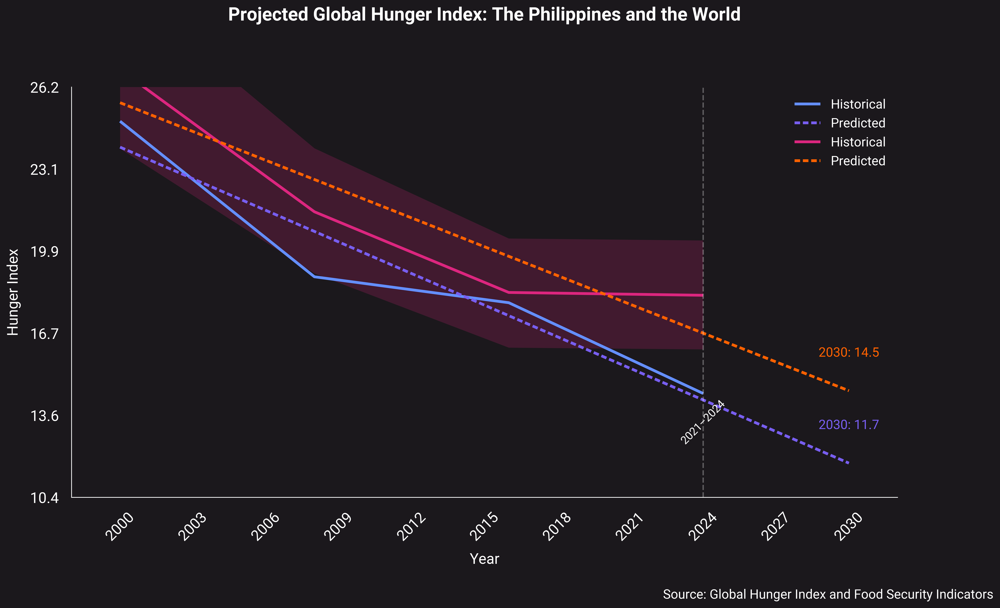

In [65]:
df_ghi_train.rename(columns={
    'GHI Index Score by 2000 range (1998–2004)': '2000',
    'GHI Index Score by 2008 range (2005–2012)': '2008',
    'GHI Index Score by 2016 range (2013–2020)': '2016',
    'GHI Index Score by 2024 range (2021–2024)': '2024'
}, inplace=True)
df_ghi_long_train = df_ghi_train.melt(
    id_vars=['Country'],
    value_vars=['2000', '2008', '2016', '2024'],
    var_name='year',
    value_name='hunger_index'
)
df_ghi_long_train['year'] = pd.to_numeric(df_ghi_long_train['year'], errors='coerce')
df_ghi_long_train['hunger_index'] = pd.to_numeric(df_ghi_long_train['hunger_index'], errors='coerce')
df_ghi_long_train.dropna(subset=['hunger_index'], inplace=True)
df_ghi_long_train['Country'] = df_ghi_long_train['Country'].str.strip()
df_ph_ghi_train = df_ghi_long_train[df_ghi_long_train['Country'] == 'Philippines']

# Prepare data
X1 = df_ph_ghi_train['year'].values.reshape(-1, 1)
y1 = df_ph_ghi_train['hunger_index'].values
X2 = df_ghi_long_train['year'].values.reshape(-1, 1)
y2 = df_ghi_long_train['hunger_index'].values

# Fit linear regression model
model1 = LinearRegression()
model1.fit(X1, y1)
model2 = LinearRegression()
model2.fit(X2, y2)

# Predict future values
future_years = np.arange(2000, 2031, 1).reshape(-1, 1)
predictions_ph = model1.predict(future_years)
y_pred_train_ph = model1.predict(X1)
predictions_global = model2.predict(future_years)
y_pred_train_global = model2.predict(X2)
mse_ph = mean_squared_error(y1, y_pred_train_ph)
r2_ph = r2_score(y1, y_pred_train_ph)
mse_global = mean_squared_error(y2, y_pred_train_global)
r2_global = r2_score(y2, y_pred_train_global)

# Visualization
historical_data_ph = pd.DataFrame({'Year': df_ph_ghi_train['year'], 'Hunger Index': df_ph_ghi_train['hunger_index'], 'Type': 'Historical'})
future_data_ph = pd.DataFrame({'Year': future_years.flatten(), 'Hunger Index': predictions_ph, 'Type': 'Predicted'})
historical_data_global = pd.DataFrame({'Year': df_ghi_long_train['year'], 'Hunger Index': df_ghi_long_train['hunger_index'], 'Type': 'Historical'})
future_data_global = pd.DataFrame({'Year': future_years.flatten(), 'Hunger Index': predictions_global, 'Type': 'Predicted'})
plot_data1 = pd.concat([historical_data_ph, future_data_ph], ignore_index=True)
plot_data2 = pd.concat([historical_data_global, future_data_global], ignore_index=True)
plt.figure(facecolor=color_bg)
ax = plt.gca()
ax.set_facecolor(color_bg)

sns.lineplot(
    data=plot_data1,
    x='Year',
    y='Hunger Index',
    hue='Type',
    style='Type',
    palette=[colors[0], colors[1]],
    linewidth=3,
    dashes={'Historical': (1, 0), 'Predicted': (2, 1)}
)

sns.lineplot(
    data=plot_data2,
    x='Year',
    y='Hunger Index',
    hue='Type',
    style='Type',
    palette=[colors[2], colors[3]],
    linewidth=3,
    dashes={'Historical': (1, 0), 'Predicted': (2, 1)}
)

#y-axis
y_min = plot_data1['Hunger Index'].min()
y_max = plot_data1['Hunger Index'].max()
y_range = y_max - y_min if y_max != y_min else 10
y_padding = 2.0 if y_range < 10 else y_range * 0.1
step = 5.0 if y_range > 20 else 2.0
y_ticks = np.arange(round(y_min - y_padding, 1), y_max + y_padding + step, step)
if len(y_ticks) > 8:
    y_ticks = np.linspace(y_min - y_padding, y_max + y_padding, 6)

ax.set_ylim(y_min - y_padding, y_max + y_padding)
ax.set_yticks(y_ticks)
ax.set_yticklabels(['%.1f' % y for y in y_ticks], fontsize=16, color=color_text)

#x-axis
x_ticks = np.arange(2000, 2031, 3)
ax.set_xticks(x_ticks)
ax.set_xticklabels([int(x) for x in x_ticks], fontsize=16, color=color_text, rotation=45)
ax.set_xlim(1998, 2032)

# Title and labels
plt.title('Projected Global Hunger Index: The Philippines and the World', fontsize=20, color=color_text)
plt.xlabel('Year', fontsize=16, color=color_text)
plt.ylabel('Hunger Index', fontsize=16, color=color_text)

# Vertical line at 2024
plt.axvline(x=2024, color='white', linestyle='--', alpha=0.3)
plt.text(2024, y_min + 0.05 * (y_max - y_min), '2021–2024', rotation=45, ha='center', va='bottom', fontsize=12, color=color_text)

# Legend
plt.legend(
    title='',
    loc='upper right',
    fontsize=14,
    labelcolor=color_text
)



ax.tick_params(axis='x', colors=color_text)
ax.tick_params(axis='y', colors=color_text)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_color(color_text)
ax.spines['bottom'].set_color(color_text)

hunger_2030_ph = predictions_ph[-1]
plt.annotate(
    f'2030: {hunger_2030_ph:.1f}',
    xy=(2030, hunger_2030_ph),
    xytext=(2030, hunger_2030_ph + y_padding),
    fontsize=14,
    color=colors[1],
    ha='center'
)

hunger_2030_global = predictions_global[-1]
plt.annotate(
    f'2030: {hunger_2030_global:.1f}',
    xy=(2030, hunger_2030_global),
    xytext=(2030, hunger_2030_global + y_padding),
    fontsize=14,
    color=colors[3],
    ha='center'
)


plt.figtext(0.99, -0.08, 'Source: Global Hunger Index and Food Security Indicators', ha='right', fontsize=14, color=color_text)


plt.show()